In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import json

with open('../config/tsp10.json') as f:
    config = json.load(f)

In [3]:
config

{'expt_name': 'tsp10',
 'gpu_id': '0',
 'train_filepath': '../dataset/tsp-data/tsp10_train_concorde.txt',
 'val_filepath': './data/tsp-data/tsp10_val_concorde.txt',
 'test_filepath': './data/tsp-data/tsp10_test_concorde.txt',
 'num_nodes': 10,
 'num_neighbors': -1,
 'node_dim': 2,
 'voc_nodes_in': 2,
 'voc_nodes_out': 2,
 'voc_edges_in': 3,
 'voc_edges_out': 2,
 'beam_size': 1280,
 'hidden_dim': 300,
 'num_layers': 30,
 'mlp_layers': 4,
 'aggregation': 'mean',
 'max_epochs': 1500,
 'val_every': 5,
 'test_every': 100,
 'batch_size': 8,
 'batches_per_epoch': 500,
 'accumulation_steps': 1,
 'learning_rate': 0.001,
 'decay_rate': 1.01}

Number of batches of size 8: 125000
Batch generation took: 0.004 sec
edges: (8, 10, 10)
edges_values: (8, 10, 10)
edges_targets: (8, 10, 10)
nodes: (8, 10)
nodes_target: (8, 10)
nodes_coord: (8, 10, 2)
tour_nodes: (8, 10)
tour_len: (8,)


<Axes: title={'center': 'default'}>

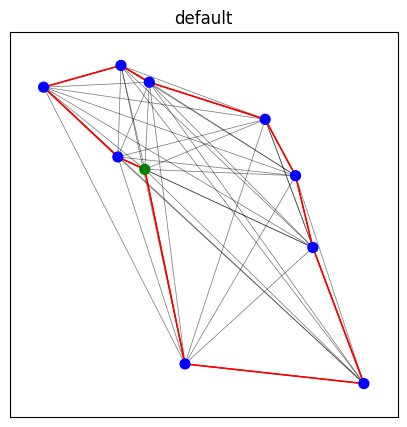

In [4]:
import time
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from tsp_gnn.data.google_loader import GoogleTSPReader
from tsp_gnn.utils.google_plots import plot_tsp

num_nodes = config['num_nodes']
num_neighbors = config['num_neighbors']
batch_size = config['batch_size']
train_filepath = config['train_filepath']
dataset = GoogleTSPReader(num_nodes, num_neighbors, batch_size, train_filepath)
print("Number of batches of size {}: {}".format(batch_size, dataset.max_iter))

t = time.time()
batch = next(iter(dataset))  # Generate a batch of TSPs
print("Batch generation took: {:.3f} sec".format(time.time() - t))

print("edges:", batch.edges.shape)
print("edges_values:", batch.edges_values.shape)
print("edges_targets:", batch.edges_target.shape)
print("nodes:", batch.nodes.shape)
print("nodes_target:", batch.nodes_target.shape)
print("nodes_coord:", batch.nodes_coord.shape)
print("tour_nodes:", batch.tour_nodes.shape)
print("tour_len:", batch.tour_len.shape)

idx = 0
f = plt.figure(figsize=(5, 5))
a = f.add_subplot(111)
plot_tsp(a, batch.nodes_coord[idx], batch.edges[idx], batch.edges_values[idx], batch.edges_target[idx])

In [5]:
import torch
from torch.autograd import Variable
from tsp_gnn.models.gcn_model import ResidualGCNModel

run_name = 'test2'

writer = SummaryWriter(log_dir=f'../logs/tensorboard/{run_name}')

model = ResidualGCNModel(config).to('cuda')
dtypeFloat = torch.cuda.FloatTensor
dtypeLong = torch.cuda.LongTensor
num_nodes = config['num_nodes']
num_neighbors = config['num_neighbors']
batch_size = config['batch_size']
train_filepath = config['train_filepath']
dataset = iter(GoogleTSPReader(num_nodes, num_neighbors, batch_size, train_filepath))
batch = next(dataset)

# Convert batch to torch Variables
x_edges = Variable(torch.FloatTensor(batch.edges).type(dtypeLong), requires_grad=False)
x_edges_values = Variable(torch.FloatTensor(batch.edges_values).type(dtypeFloat), requires_grad=False)
x_nodes = Variable(torch.LongTensor(batch.nodes).type(dtypeLong), requires_grad=False)
x_nodes_coord = Variable(torch.FloatTensor(batch.nodes_coord).type(dtypeFloat), requires_grad=False)
y_edges = Variable(torch.LongTensor(batch.edges_target).type(dtypeLong), requires_grad=False)
y_nodes = Variable(torch.LongTensor(batch.nodes_target).type(dtypeLong), requires_grad=False)

edge_labels = y_edges.cpu().numpy().flatten()
y_prob, y_log_prob = model(x_edges_values, x_nodes_coord)
loss = model.loss(y_log_prob, y_edges)

edge mean:tensor([ 7.6890e-07, -1.3530e-07, -9.5367e-09, -2.0266e-08, -3.1710e-07,
        -7.7486e-08,  2.4438e-08, -5.1260e-08,  2.3246e-08, -1.3098e-07,
         5.9009e-08, -1.4365e-07, -9.5367e-09,  2.3842e-09,  5.0068e-08,
         7.8678e-08, -3.0994e-08,  8.6427e-08,  3.3379e-08,  1.5736e-07,
         6.9141e-08,  5.9009e-08,  3.0160e-07,  4.6492e-08, -3.8743e-08,
         4.2915e-08, -2.6226e-08,  1.9997e-07, -1.7881e-09, -3.1888e-08,
         1.4305e-07,  1.4484e-07,  3.2961e-07,  1.0967e-07, -4.4107e-08,
         6.2644e-07, -6.0201e-07,  5.6028e-07,  2.8983e-07, -7.3314e-08,
        -2.4140e-07,  8.3447e-08, -2.1011e-07,  3.5763e-09, -8.0466e-08,
        -5.9605e-09,  1.1802e-07, -1.6868e-07,  5.7220e-08,  7.9870e-08,
        -8.3447e-09, -4.4107e-08,  2.9802e-08,  3.6955e-08,  4.9472e-08,
        -1.3411e-07, -2.9504e-08, -3.4511e-07,  4.2140e-07,  4.7684e-08,
         3.4392e-07, -2.7418e-08,  4.5896e-08,  6.3062e-07, -8.3447e-09,
         6.9141e-08, -1.4901e-08, -9.8944

In [6]:
loss

tensor(0.6913, device='cuda:0', grad_fn=<NllLoss2DBackward0>)

In [7]:
learning_rate = config['learning_rate']
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

In [8]:
def train(model, optimizer, config, writer, num_epochs=1):
    num_nodes = config['num_nodes']
    num_neighbors = config['num_neighbors']
    batch_size = config['batch_size']
    batches_per_epoch = config['batches_per_epoch']
    accumulation_steps = config['accumulation_steps']
    train_filepath = config['train_filepath']
    dataset = GoogleTSPReader(num_nodes, num_neighbors, batch_size, train_filepath)
    dataset_iter = iter(dataset)

    if batches_per_epoch == -1:
        batches_per_epoch = dataset.max_iter
    else:
        batches_per_epoch = min(batches_per_epoch, dataset.max_iter)
    
    running_loss = 0.0

    running_pred_tour_len = 0.0
    running_gt_tour_len = 0.0
    running_nb_batch = 0
    running_nb_batch = 0
    for epoch in range(num_epochs):
        for batch_num in range(batches_per_epoch):
            try:
                batch = next(dataset_iter)
            except StopIteration:
                break
            
            # Convert batch to torch Variables
            x_edges = Variable(torch.FloatTensor(batch.edges).type(dtypeLong), requires_grad=False)
            x_edges_values = Variable(torch.FloatTensor(batch.edges_values).type(dtypeFloat), requires_grad=False)
            x_nodes = Variable(torch.LongTensor(batch.nodes).type(dtypeLong), requires_grad=False)
            x_nodes_coord = Variable(torch.FloatTensor(batch.nodes_coord).type(dtypeFloat), requires_grad=False)
            y_edges = Variable(torch.LongTensor(batch.edges_target).type(dtypeLong), requires_grad=False)
            y_nodes = Variable(torch.LongTensor(batch.nodes_target).type(dtypeLong), requires_grad=False)
            
            y_prob, y_log_prob = model.forward(x_edges_values, x_nodes_coord)

            loss = model.loss(y_log_prob, y_edges)
            loss = loss.contiguous()
            loss.backward()
            
            if (batch_num+1) % accumulation_steps == 0:
                optimizer.step()
                optimizer.zero_grad()
            
            running_loss += loss.item()
            writer.add_scalar('loss', loss.item(), epoch * batches_per_epoch + batch_num)
            break
    writer.close()

In [9]:
train(model, optimizer, config, writer, num_epochs=120)

edge mean:tensor([-2.3246e-07, -3.7074e-07, -1.4901e-07, -1.9670e-08,  2.9564e-07,
         1.1921e-09, -4.8637e-07,  2.0981e-07, -1.6689e-08, -3.7849e-07,
         4.0531e-08,  1.4782e-07, -5.4836e-08, -7.7486e-09, -4.2915e-08,
         6.1989e-08, -2.5034e-08,  1.1683e-07,  1.0610e-07, -5.2452e-08,
        -4.7684e-09,  8.4639e-08,  7.5102e-08, -9.5367e-09, -2.3842e-08,
        -5.2452e-08,  4.7684e-09, -8.1062e-08,  1.1921e-08,  3.7372e-07,
        -2.2531e-07,  8.1062e-08,  2.3842e-08,  4.0531e-08,  1.6212e-07,
        -2.6226e-08, -5.4836e-08,  4.5896e-07, -5.4836e-08,  3.1471e-07,
        -2.6703e-07,  1.7881e-07, -3.4332e-07, -6.7949e-08, -3.1233e-07,
        -2.3842e-09, -7.8678e-08, -1.0252e-07, -1.2040e-07,  5.9605e-09,
         0.0000e+00, -4.6492e-08, -1.1086e-07, -5.6028e-08,  5.8413e-08,
        -1.0252e-07, -2.8610e-07,  8.6069e-07,  4.4584e-07,  8.4639e-08,
         2.9564e-07, -1.7881e-08,  5.7220e-08,  2.7418e-08, -1.5110e-07,
         0.0000e+00,  5.7220e-08, -4.0770

In [10]:
y_prob, y_log_prob = model(x_edges_values, x_nodes_coord)

edge mean:tensor([-1.2548e-03, -5.1419e-03,  5.7087e-03, -5.6820e-03, -2.3532e-02,
         1.2417e-02, -8.3931e-03,  3.9054e-03, -2.0995e-02, -3.4276e-02,
        -4.6494e-03, -2.3639e-02, -9.9115e-03,  1.4655e-02, -1.4516e-02,
        -8.2042e-03, -8.1647e-03, -2.1830e-02,  1.6737e-02,  3.1020e-03,
         1.6694e-02,  8.6630e-03,  7.0505e-03,  1.3672e-02,  2.5840e-02,
        -2.2299e-02,  2.9181e-02, -3.7178e-02,  3.7394e-02,  6.5444e-03,
        -5.5212e-03,  2.5641e-03, -8.8005e-03, -1.9557e-02,  5.3686e-03,
        -5.7897e-03, -2.1379e-02, -3.5228e-02,  2.1890e-02, -5.1291e-03,
         4.3231e-04, -2.7004e-02,  6.1768e-03, -8.3224e-03, -3.7209e-02,
         8.6656e-03, -4.0157e-03, -2.4677e-02, -3.6085e-02,  8.2116e-03,
        -7.2031e-03, -9.5437e-04, -3.6129e-02, -5.6576e-03, -2.2223e-03,
        -9.4962e-03, -2.6066e-02, -4.7516e-02, -1.4333e-02, -2.9542e-02,
         3.0470e-02, -2.3673e-03, -9.3515e-03, -2.8376e-03, -9.8874e-03,
        -1.4688e-02, -2.2662e-03, -1.7299

In [11]:
y_prob[0, :, :, 1]

tensor([[1.1442e-02, 7.7369e-03, 1.2545e-01, 1.9629e-02, 1.1857e-03, 5.0000e-01,
         1.2683e-04, 5.0000e-01, 3.1315e-01, 1.1268e-03],
        [7.7369e-03, 4.6365e-01, 7.6753e-03, 5.0000e-01, 1.8952e-02, 1.0259e-03,
         1.4847e-01, 3.9212e-02, 2.1486e-01, 5.0000e-01],
        [1.2545e-01, 7.6753e-03, 1.7854e-04, 7.7973e-05, 5.0000e-01, 5.0000e-01,
         1.1044e-01, 5.4103e-03, 1.0129e-04, 8.0077e-02],
        [1.9629e-02, 5.0000e-01, 7.7973e-05, 5.8131e-02, 3.9299e-04, 1.0393e-04,
         4.5116e-02, 1.3136e-01, 5.0000e-01, 1.9588e-01],
        [1.1857e-03, 1.8952e-02, 5.0000e-01, 3.9299e-04, 1.7847e-03, 5.5717e-02,
         5.0000e-01, 3.2652e-04, 1.3692e-04, 1.8825e-01],
        [5.0000e-01, 1.0259e-03, 5.0000e-01, 1.0393e-04, 5.5717e-02, 1.0896e-02,
         1.2420e-04, 4.5890e-01, 1.6467e-03, 1.2630e-03],
        [1.2683e-04, 1.4847e-01, 1.1044e-01, 4.5116e-02, 5.0000e-01, 1.2420e-04,
         3.2823e-02, 5.4924e-04, 5.7814e-03, 3.9404e-01],
        [5.0000e-01, 3.9212

In [12]:
y_edges[idx]

tensor([[0, 0, 0, 0, 0, 1, 0, 1, 0, 0],
        [0, 0, 0, 1, 0, 0, 0, 0, 0, 1],
        [0, 0, 0, 0, 1, 1, 0, 0, 0, 0],
        [0, 1, 0, 0, 0, 0, 0, 0, 1, 0],
        [0, 0, 1, 0, 0, 0, 1, 0, 0, 0],
        [1, 0, 1, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 1, 0, 0, 0, 0, 1],
        [1, 0, 0, 0, 0, 0, 0, 0, 1, 0],
        [0, 0, 0, 1, 0, 0, 0, 1, 0, 0],
        [0, 1, 0, 0, 0, 0, 1, 0, 0, 0]], device='cuda:0')

<Axes: title={'center': 'default'}>

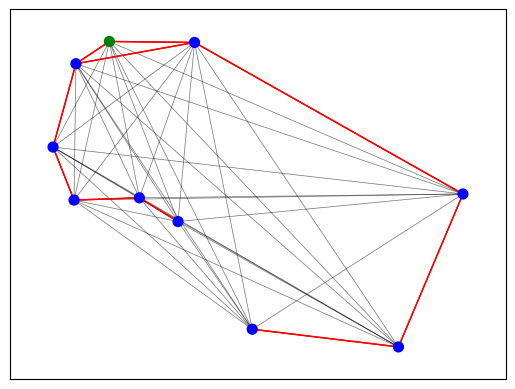

In [15]:
plot_tsp(a, batch.nodes_coord[idx], batch.edges[idx], batch.edges_values[idx], (y_prob[idx, :, :, 1] > 0.4).cpu().detach().numpy())

<Axes: title={'center': 'default'}>

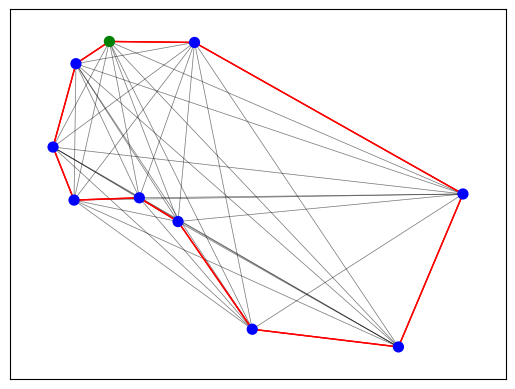

In [14]:
plot_tsp(a, batch.nodes_coord[idx], batch.edges[idx], batch.edges_values[idx], batch.edges_target[idx])